In [1]:
from PIL import Image
import math
from pathlib import Path
Image.MAX_IMAGE_PIXELS = None
import glob

In [2]:
import numpy as np
import itertools as it
import os, sys
class Tiler(object):
    """docstring for Tiler"""
    def __init__(self, size=(1280, 1280), buffer=20,
                 outDir="out", outFileExt="png"):
        super(Tiler, self).__init__()
        self.xSize, self.ySize = size
        self.buffer = buffer
        self.outDir = outDir
        self.outFileExt = outFileExt
        
        self.outDir = Path(outDir)
        self.outDir.mkdir(parents=True, exist_ok=True)

    def tile(self, file):
        try:
            print(file)
            with Image.open(file) as image:
                name = Path(file).stem
                # get number of tiles
                nX = np.ceil((image.size[0]-self.buffer)/(self.xSize-self.buffer)).astype(int)
                nY = np.ceil((image.size[1]-self.buffer)/(self.ySize-self.buffer)).astype(int)
                # pad the image
                pad = (nX*(self.xSize-self.buffer)+self.buffer-image.size[0],
                       nY*(self.ySize-self.buffer)+self.buffer-image.size[1])
                image = self.addMargin(image, pad)
                # loop over square index to get top left of point and cropped image
                print(f"tileing file {name}")
                for (i,j) in it.product(range(nX), range(nY)):
                    xx= i*(self.xSize-self.buffer)
                    yy= j*(self.xSize-self.buffer)
                    crop = image.crop((xx, yy, xx + self.xSize, yy + self.ySize))
                    outfile = Path(name+f'_{i}_{j}.{self.outFileExt}')
                    crop.save(self.outDir/outfile )
                print("\tdone")
        except OSError as e:
            print("cannot open", file, e)
    
    def addMargin(self, image, pad, color=(255, 255, 255)):
        width, height = image.size
        result = Image.new(image.mode, (width+pad[0], height+pad[1]), color)
        result.paste(image, (0, 0))
        return result
        

['waddle\\croz.tif',
 'waddle\\royds_20191204_v4.tif',
 'waddle\\royds_20200127_v2.tif',
 'waddle\\tie.tif']

In [10]:
tiler = Tiler(size=(512, 256), outDir="waddle\\tiles")
for file in glob.glob("waddle\\*.*"):
    if "croz" in file:
        tiler.tile(file)

waddle\croz.tif
cannot open waddle\croz.tif cannot identify image file 'waddle\\croz.tif'
waddle\croz_20201129_v1_tiled-0-0.tif
cannot open waddle\croz_20201129_v1_tiled-0-0.tif cannot identify image file 'waddle\\croz_20201129_v1_tiled-0-0.tif'
waddle\croz_20201129_v1_tiled-4-10.tif
tileing file croz_20201129_v1_tiled-4-10
	done


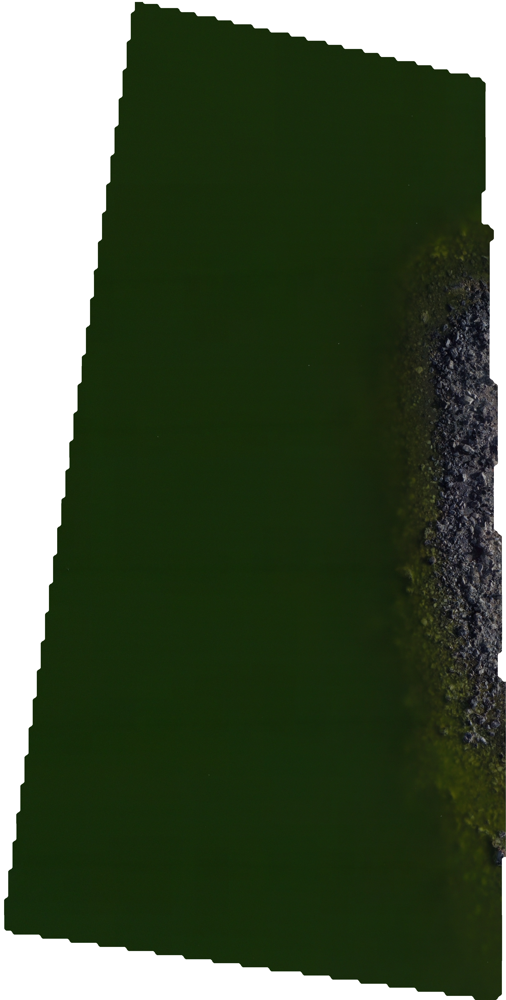

hello
